
<h2 style="background-color:#0E6B57;font-family:newtimeroman;color:#EBDEF0;font-size:180%;text-align:center;border-radius:10px 10px;"> Project: Uber Fare Rate Prediction in New York City</h2>


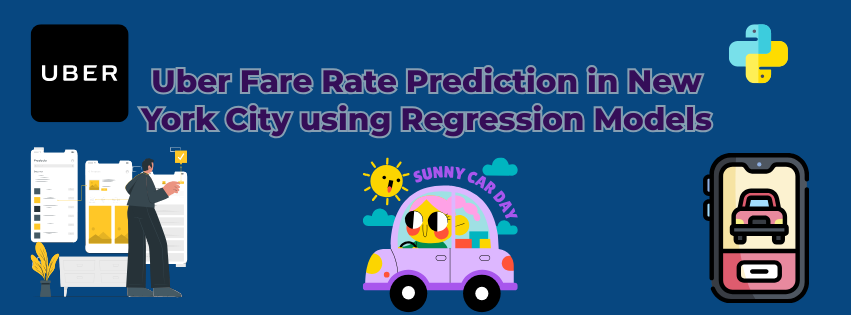

# 🐸 Description:

The project is about on world's largest taxi company Uber inc. In this project, we're looking to predict the fare for their future transactional cases. Uber delivers service to lakhs of customers daily. Now it becomes really important to manage their data properly to come up with new business ideas to get best results. Eventually, it becomes really importaant to estimate the fare prices accurately.
The dataset is containing 200000 trips of users in New York City, USA

#	🔮 Import Required Libraries:

In [2]:
#dataframe
import pandas as pd
#mathemetical computing
import numpy as np

#visualization
import matplotlib.pyplot as plt
import seaborn as sns

#geo location
import geopandas as gpd
from geopandas import GeoDataFrame
from shapely.geometry import Point, Polygon

#for plotly
import plotly.express as px
import plotly.graph_objects as go
#distance wrt lat/long
import geopy.distance
#for datetime to numeric conversion using strftime
import datetime

#data preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

#splitting dataset, sampling and normalization
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import StandardScaler

#different types of regression model
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.neighbors import KNeighborsRegressor
from xgboost import XGBRegressor
from sklearn.ensemble import RandomForestRegressor

#error
from sklearn.metrics import mean_absolute_error
#accuracy and R1
from sklearn.metrics import r2_score, explained_variance_score

#best parameters for hyperparameter tuning
from sklearn.model_selection import GridSearchCV
#evaluation of dataset
from sklearn.model_selection import StratifiedKFold

#save model
import joblib
#remove warning
import warnings
warnings.filterwarnings("ignore")

# 💁 Load Dataset

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
path = "/content/drive/MyDrive/Uber Dataset/uber.csv"

dataframe = pd.read_csv(path)
dataframe

,Unnamed: 0,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,24238194,2015-05-07 19:52:06.0000003,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1
1,27835199,2009-07-17 20:04:56.0000002,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1
2,44984355,2009-08-24 21:45:00.00000061,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1
3,25894730,2009-06-26 08:22:21.0000001,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3
4,17610152,2014-08-28 17:47:00.000000188,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5
...,...,...,...,...,...,...,...,...,...
199995,42598914,2012-10-28 10:49:00.00000053,3.0,2012-10-28 10:49:00 UTC,-73.987042,40.739367,-73.986525,40.740297,1
199996,16382965,2014-03-14 01:09:00.0000008,7.5,2014-03-14 01:09:00 UTC,-73.984722,40.736837,-74.006672,40.739620,1
199997,27804658,2009-06-29 00:42:00.00000078,30.9,2009-06-29 00:42:00 UTC,-73.986017,40.756487,-73.858957,40.692588,2
199998,20259894,2015-05-20 14:56:25.0000004,14.5,2015-05-20 14:56:25 UTC,-73.997124,40.725452,-73.983215,40.695415,1


# 🐍 Data Preprocessing


In [21]:
#copy dataframe
df = dataframe.copy()
print("Details Information of df:")
print(df.info())

print(f'shape of dataset:{df.shape}')
print("Data Discription: ", "\n")
print(df.describe())
#missing value remove
df = df.dropna()

print("Details Information of df:")

print(df.info())

Details Information of df:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 9 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Unnamed: 0         200000 non-null  int64  
 1   key                200000 non-null  object 
 2   fare_amount        200000 non-null  float64
 3   pickup_datetime    200000 non-null  object 
 4   pickup_longitude   200000 non-null  float64
 5   pickup_latitude    200000 non-null  float64
 6   dropoff_longitude  199999 non-null  float64
 7   dropoff_latitude   199999 non-null  float64
 8   passenger_count    200000 non-null  int64  
dtypes: float64(5), int64(2), object(2)
memory usage: 13.7+ MB
None
shape of dataset:(200000, 9)
Data Discription:  

         Unnamed: 0    fare_amount  pickup_longitude  pickup_latitude  \
count  2.000000e+05  200000.000000     200000.000000    200000.000000   
mean   2.771250e+07      11.359955        -72.527638        

In [22]:
# count unique value of each column
cols = df.columns

for col in cols:
    v= df[col].unique()
    print("Column Name: ", col)
    print("Unique Value Counts: ",len(v))

Column Name:  Unnamed: 0
Unique Value Counts:  199999
Column Name:  key
Unique Value Counts:  199999
Column Name:  fare_amount
Unique Value Counts:  1244
Column Name:  pickup_datetime
Unique Value Counts:  196628
Column Name:  pickup_longitude
Unique Value Counts:  71065
Column Name:  pickup_latitude
Unique Value Counts:  83835
Column Name:  dropoff_longitude
Unique Value Counts:  76894
Column Name:  dropoff_latitude
Unique Value Counts:  90585
Column Name:  passenger_count
Unique Value Counts:  8




<h3> 🔍  Outlier Detection and Remove </h3>

In [23]:
#define plot for outliers
def plot_oulier(columns):
  ax = columns.plot(kind = 'box', title = 'boxplot', showmeans = True)
  plt.grid()
  plt.show()
  plt.tight_layout()

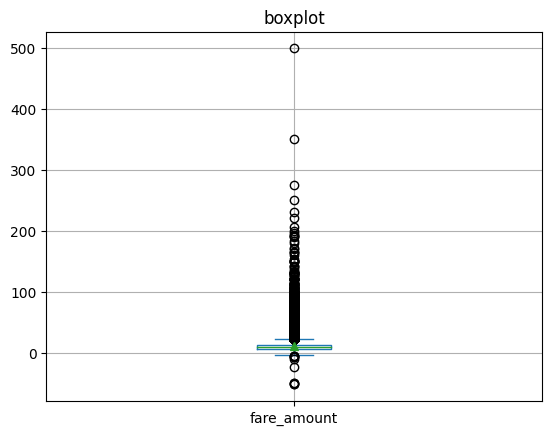

<Figure size 640x480 with 0 Axes>

In [24]:
# for fare_amount
plot_oulier(df['fare_amount'])

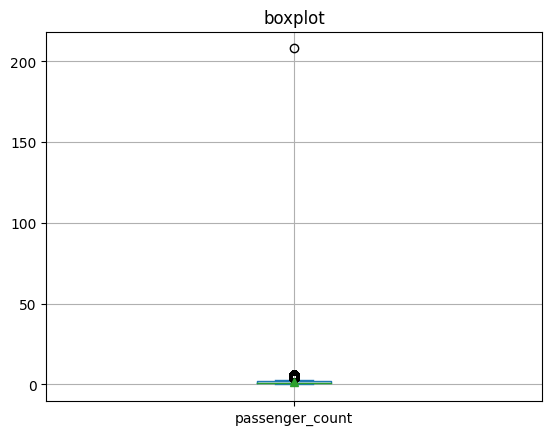

<Figure size 640x480 with 0 Axes>

In [25]:
#for passenger count
plot_oulier(df['passenger_count'])

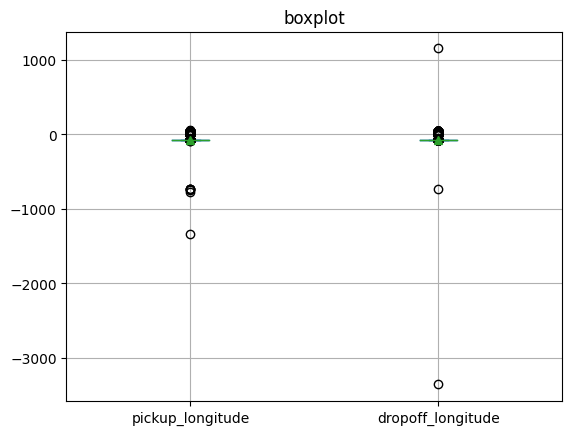

<Figure size 640x480 with 0 Axes>

In [26]:
#pick and drop longitude
plot_oulier(df[['pickup_longitude', 'dropoff_longitude']])

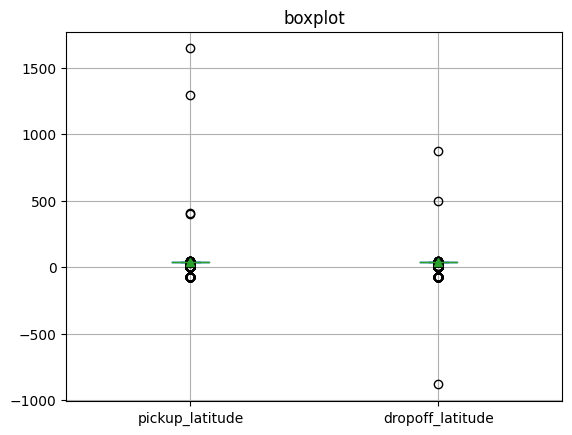

<Figure size 640x480 with 0 Axes>

In [27]:
#pick and drop latitude
plot_oulier(df[['pickup_latitude', 'dropoff_latitude']])

In [28]:
#drop unnecessary columns
df = df.drop(['Unnamed: 0', 'key'], axis =1)
df.shape

(199999, 7)

<h3>👇 Remove Outliers </h3>

In [29]:
#define outliers
def outlier(dataset, col):

    Q1 = dataset[col].quantile(0.25)
    Q3 = dataset[col].quantile(0.75)
    IQR = Q3 - Q1
    lower = Q1 - 1.5*IQR
    upper = Q3 + 1.5*IQR
    result =(lower,upper)

    return list(result)

In [30]:
outlier(df,'pickup_longitude')

[-74.02943149999999, -73.92978750000003]

In [31]:
#remove outliers in different columns
df = df[(df.pickup_longitude>=outlier(df, 'pickup_longitude')[0]) & (df.pickup_longitude<=outlier(df, 'pickup_longitude')[1])]
df = df[(df.pickup_latitude>=outlier(df, 'pickup_latitude')[0]) & (df.pickup_latitude<=outlier(df, 'pickup_latitude')[1])]
df = df[(df.dropoff_longitude>=outlier(df, 'dropoff_longitude')[0]) & (df.dropoff_longitude<=outlier(df, 'dropoff_longitude')[1])]
df = df[(df.dropoff_latitude>=outlier(df, 'dropoff_latitude')[0]) & (df.dropoff_latitude<=outlier(df, 'dropoff_latitude')[1])]
df = df[(df.fare_amount>=outlier(df, 'fare_amount')[0]) & (df.fare_amount<=outlier(df, 'fare_amount')[1])]


In [32]:
print(f'shape of dataset after removing outliers: {df.shape}')

shape of dataset after removing outliers: (163837, 7)


# 💡 Exploratory Data Analysis (EDA)

In [35]:
print("number of passengers in each rides")
print(df['passenger_count'].value_counts())
#find index of outlier
print(df[df['passenger_count']==208])

#drop outlier by index
df = df.drop(index=113038)
#ignore zero passenger
df = df[df['passenger_count']>=1]
df[:5]

number of passengers in each rides
1      113542
2       23877
5       11464
3        7347
4        3528
6        3476
0         602
208         1
Name: passenger_count, dtype: int64
        fare_amount          pickup_datetime  pickup_longitude  \
113038         11.7  2010-12-28 08:20:00 UTC        -73.937795   

        pickup_latitude  dropoff_longitude  dropoff_latitude  passenger_count  
113038        40.758498         -73.937835         40.758415              208  


,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1
1,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1
2,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1
3,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3
5,4.9,2011-02-12 02:27:09 UTC,-73.969019,40.755910,-73.969019,40.755910,1


In [37]:
print("passenger counts after removing zero passenger:")

df['passenger_count'].value_counts()

passenger counts after removing zero passenger:


1    113542
2     23877
5     11464
3      7347
4      3528
6      3476
Name: passenger_count, dtype: int64

In [38]:
print(f"shape of dataset: {df.shape}")

shape of dataset: (163234, 7)


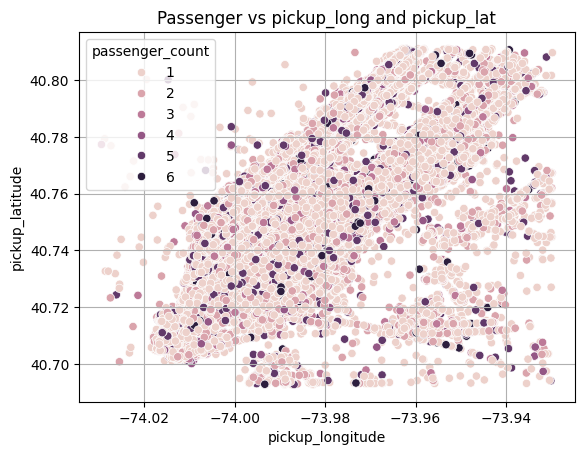

<Figure size 640x480 with 0 Axes>

In [42]:
#scatter plot of pickup_longitude and pickup_latitude
sns.scatterplot(df, x='pickup_longitude', y='pickup_latitude', hue = 'passenger_count')
plt.grid()
plt.title("Passenger vs pickup_long and pickup_lat")
plt.show()
plt.tight_layout()

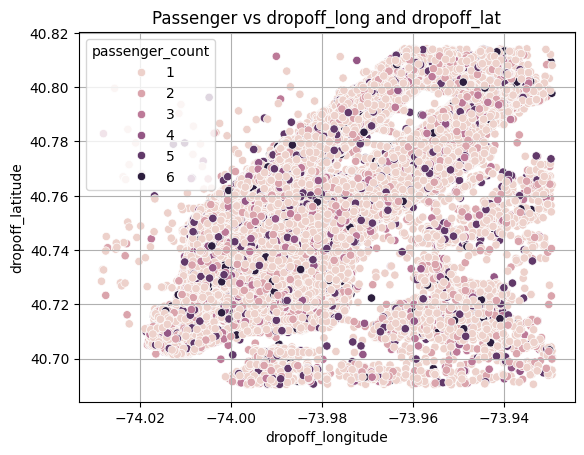

<Figure size 640x480 with 0 Axes>

In [41]:
#scatter plot of dropoff_longitude and dropoff_latitude
sns.scatterplot(df, x='dropoff_longitude', y='dropoff_latitude', hue = 'passenger_count')
plt.grid()
plt.title("Passenger vs dropoff_long and dropoff_lat")
plt.show()
plt.tight_layout()

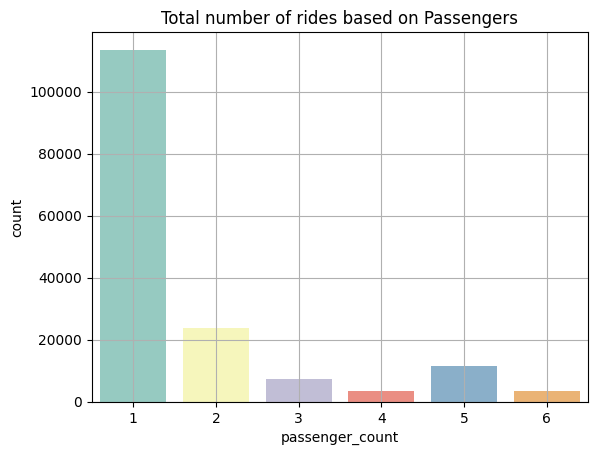

<Figure size 640x480 with 0 Axes>

In [43]:
#passenger plot
sns.countplot(x='passenger_count', data = df, palette = "Set3")
plt.grid()
plt.title("Total number of rides based on Passengers")
plt.show()
plt.tight_layout()


<h4>🚩 Most of the passenger  are single passenger who take Uber ride</h4>

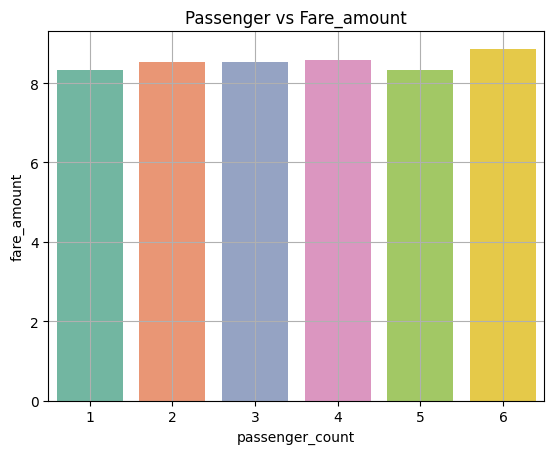

<Figure size 640x480 with 0 Axes>

In [47]:
#passenger vs fare
sns.barplot(x="passenger_count", y = "fare_amount", data = df,ci = None, palette = "Set2")
plt.grid()
plt.title("Passenger vs Fare_amount")
plt.show()
plt.tight_layout()

### ⏰ Date Time Re-Arrangement

In [51]:
#type(df['pickup_datetime'])

In [50]:
df['pickup_datetime'][2:5]

2    2009-08-24 21:45:00 UTC
3    2009-06-26 08:22:21 UTC
5    2011-02-12 02:27:09 UTC
Name: pickup_datetime, dtype: object

In [52]:
df['pickup_datetime'] = pd.to_datetime(df['pickup_datetime'])
df['pickup_datetime'] = df['pickup_datetime'].dt.strftime("%Y-%m-%d %H:%M")
df['pickup_datetime'] = pd.to_datetime(df['pickup_datetime'])

In [53]:
df['pickup_datetime'][2:5]


2   2009-08-24 21:45:00
3   2009-06-26 08:22:00
5   2011-02-12 02:27:00
Name: pickup_datetime, dtype: datetime64[ns]

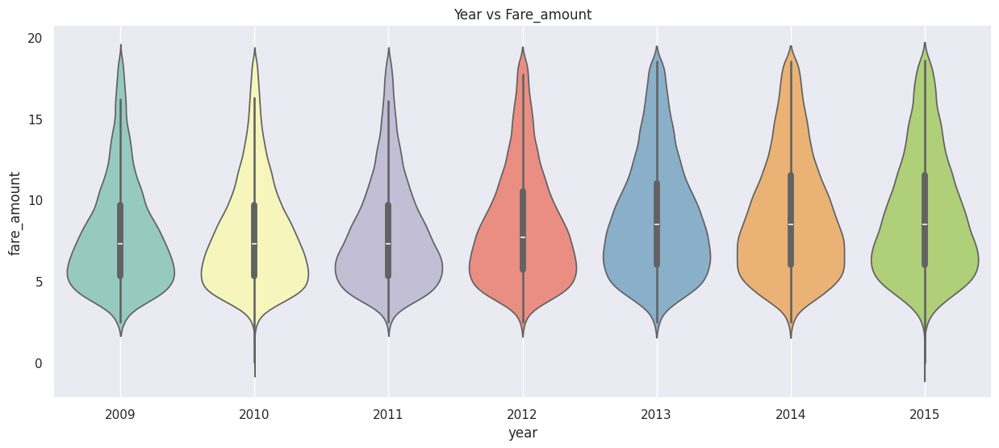

<Figure size 1500x600 with 0 Axes>

In [57]:
#yearly fare distribution
df_year = df.copy()

df_year['year'] = df['pickup_datetime'].dt.year
df_year
sns.violinplot(x = 'year', y = 'fare_amount', data = df_year, palette = "Set3")
plt.grid()
plt.title('Year vs Fare_amount')
plt.show()
plt.tight_layout()


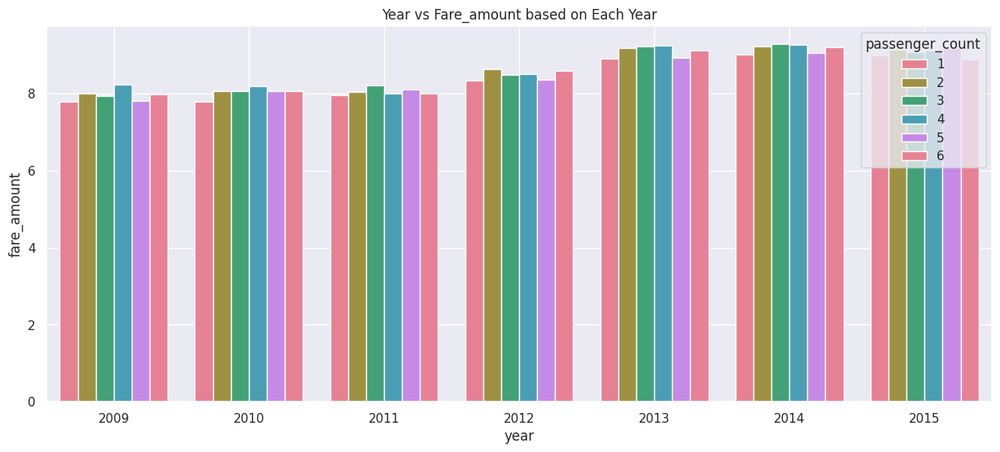

<Figure size 1800x600 with 0 Axes>

In [58]:
#yearly fare distribution with respect to passenger
sns.barplot(x = 'year', y = 'fare_amount', data = df_year, hue = "passenger_count", ci = None, palette = "husl")
sns.set(rc = {'figure.figsize':(18, 6)})
plt.grid(True)
plt.title('Year vs Fare_amount based on Each Year')
plt.show()
plt.tight_layout()

<h4>🚩 Fare amount varies a little with respect to number of passenger. There is a jump in fare amount in between 2012 and 2013</h4>

In [59]:
#average fare per year
avg = df_year.groupby(['year'], as_index = False)['fare_amount'].mean()

avg

,year,fare_amount
0,2009,7.844255
1,2010,7.880556
2,2011,7.996691
3,2012,8.394690
4,2013,8.983126
5,2014,9.070080
6,2015,9.037344


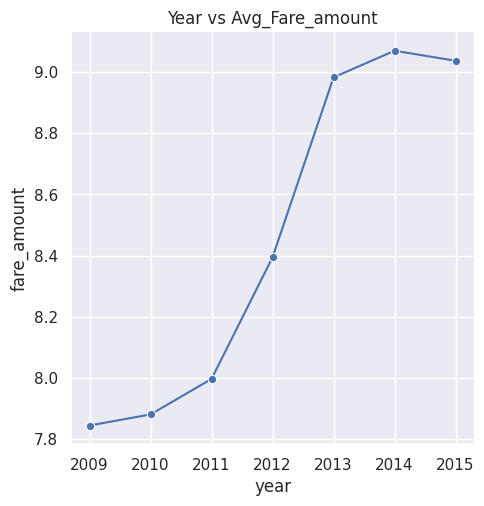

<Figure size 1800x600 with 0 Axes>

In [60]:
sns.relplot(x='year',y='fare_amount', data = avg, kind="line", marker = "o")

plt.grid(True)
plt.title('Year vs Avg_Fare_amount')
plt.show()
plt.tight_layout()

# 🌎 Geo-ploting

In [62]:
geolocation = [Point(x,y) for x,y in zip(df['pickup_longitude'], df['pickup_latitude'])]
#print("Geolocation details: ")
geolocation[0:10]

[<POINT (-74 40.738)>,
 <POINT (-73.994 40.728)>,
 <POINT (-74.005 40.741)>,
 <POINT (-73.976 40.791)>,
 <POINT (-73.969 40.756)>,
 <POINT (-73.975 40.746)>,
 <POINT (-74.001 40.742)>,
 <POINT (-73.974 40.747)>,
 <POINT (-73.966 40.804)>,
 <POINT (-73.953 40.767)>]

In [63]:
gdf = GeoDataFrame(df, geometry=geolocation, crs={'init':'epsg:4326'})
print("GeoLocation Dataframe")
gdf

GeoLocation Dataframe


,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,geometry
0,7.5,2015-05-07 19:52:00,-73.999817,40.738354,-73.999512,40.723217,1,POINT (-73.99982 40.73835)
1,7.7,2009-07-17 20:04:00,-73.994355,40.728225,-73.994710,40.750325,1,POINT (-73.99435 40.72823)
2,12.9,2009-08-24 21:45:00,-74.005043,40.740770,-73.962565,40.772647,1,POINT (-74.00504 40.74077)
3,5.3,2009-06-26 08:22:00,-73.976124,40.790844,-73.965316,40.803349,3,POINT (-73.97612 40.79084)
5,4.9,2011-02-12 02:27:00,-73.969019,40.755910,-73.969019,40.755910,1,POINT (-73.96902 40.75591)
...,...,...,...,...,...,...,...,...
199994,12.0,2014-01-31 14:42:00,-73.983070,40.760770,-73.972972,40.754177,1,POINT (-73.98307 40.76077)
199995,3.0,2012-10-28 10:49:00,-73.987042,40.739367,-73.986525,40.740297,1,POINT (-73.98704 40.73937)
199996,7.5,2014-03-14 01:09:00,-73.984722,40.736837,-74.006672,40.739620,1,POINT (-73.98472 40.73684)
199998,14.5,2015-05-20 14:56:00,-73.997124,40.725452,-73.983215,40.695415,1,POINT (-73.99712 40.72545)


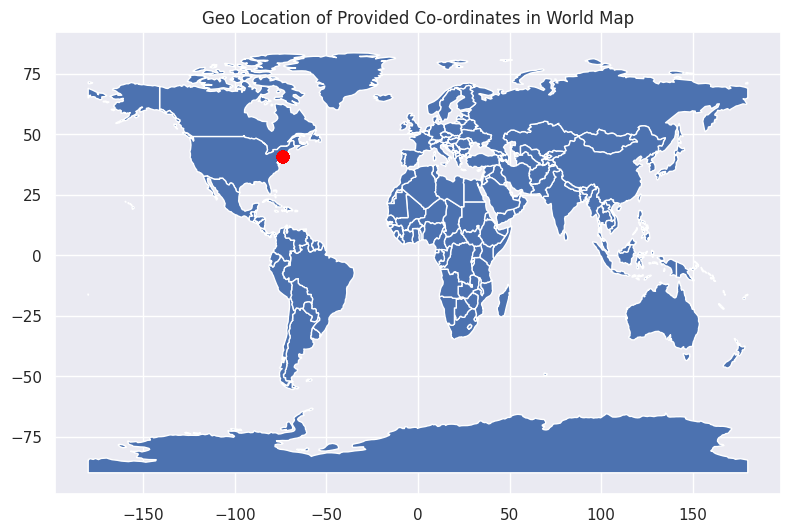

In [67]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

gdf.plot(ax=world.plot(figsize=(10, 6)), marker='o', color='red', markersize=50);
plt.title("Geo Location of Provided Co-ordinates in World Map")
plt.show()

**📌Note:** Have a look for more details about GeoData
1. https://towardsdatascience.com/geopandas-101-plot-any-data-with-a-latitude-and-longitude-on-a-map-98e01944b972
2. https://community.plotly.com/t/plotly-not-working-on-google-colab/76288

In [ ]:
#df_pickup = df[['pickup_latitude', 'pickup_longitude', 'passenger_count']]

fig = px.scatter_mapbox(df, lat = 'pickup_latitude', lon = 'pickup_longitude', color= 'passenger_count', size="passenger_count",
title = "Uber Pickup Location", color_discrete_sequence=["fuchsia"], zoom=11, height=500)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
fig = px.scatter_mapbox(df, lat = 'dropoff_latitude', lon = 'dropoff_longitude', color= 'passenger_count', size="passenger_count",
title = "Uber Pickup Location", color_discrete_sequence=["fuchsia"], zoom=11, height=500)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
df1 = df[['pickup_latitude', 'pickup_longitude']]
df1['location']='pickup'
df1.rename(columns = {'pickup_longitude':'longitude', 'pickup_latitude': 'latitude'}, inplace = True)
df2 = df[['dropoff_latitude', 'dropoff_longitude']]
df2['location']='dropoff'
df2.rename(columns = {'dropoff_longitude':'longitude', 'dropoff_latitude': 'latitude'}, inplace = True)

In [ ]:
df_melt = pd.concat([df1, df2])
df_melt['location'].replace(['pickup', 'dropoff'],
                        [0, 1], inplace=True)

In [ ]:

fig = px.scatter_mapbox(df_melt, lat = 'latitude', lon = 'longitude', color= 'location',
title = "Uber Pickup Location", color_discrete_sequence=["fuchsia"], zoom=15, height=500)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# 🔔 Measuring distance and fare analysis

### Import Libraries

In [69]:
#import libraries
import geopy.distance

In [70]:
df_distance = df.copy()
df_distance['pickup_coordinate'] = df[['pickup_latitude', 'pickup_longitude']].apply(tuple, axis=1)
df_distance['dropoff_coordinate'] = df[['dropoff_latitude', 'dropoff_longitude']].apply(tuple, axis=1)

In [71]:
import geopy.distance
coordinate1 = df_distance['pickup_coordinate'].tolist()
coordinate2 = df_distance['dropoff_coordinate'].tolist()

dist = []
for i,j in zip(coordinate1, coordinate2):
  dis = geopy.distance.geodesic(i, j).km
  dist.append(dis)

In [72]:
df_distance['distance'] = dist

In [73]:
print('distance between pickup and dropoff')

df_distance['distance']

distance between pickup and dropoff


0         1.681111
1         2.454363
2         5.039603
3         1.661442
5         0.000000
            ...   
199994    1.123897
199995    0.112128
199996    1.879635
199998    3.536552
199999    5.410678
Name: distance, Length: 163234, dtype: float64

In [76]:
print("Find the dataframe where pickup and dropoff distance is zero or same location: \n \n")
df_distance[(df_distance.pickup_longitude ==df_distance['dropoff_longitude']) & (df_distance.pickup_latitude==df_distance['dropoff_latitude'])]

Find the dataframe where pickup and dropoff distance is zero or same location: 
 



,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,pickup_coordinate,dropoff_coordinate,distance
5,4.9,2011-02-12 02:27:00,-73.969019,40.755910,-73.969019,40.755910,1,"(40.75591, -73.96901899999999)","(40.75591, -73.96901899999999)",0.0
166,4.5,2014-01-22 21:01:00,-73.992937,40.757780,-73.992937,40.757780,1,"(40.75778, -73.992937)","(40.75778, -73.992937)",0.0
467,4.9,2011-01-10 10:14:00,-74.002718,40.760635,-74.002718,40.760635,2,"(40.760635, -74.002718)","(40.760635, -74.002718)",0.0
733,6.9,2010-05-01 13:06:00,-73.992287,40.721032,-73.992287,40.721032,5,"(40.721032, -73.992287)","(40.721032, -73.992287)",0.0
1052,6.1,2010-05-17 11:22:00,-73.970428,40.761733,-73.970428,40.761733,2,"(40.761733, -73.970428)","(40.761733, -73.970428)",0.0
...,...,...,...,...,...,...,...,...,...,...
198788,5.3,2009-08-14 13:05:00,-73.979123,40.752760,-73.979123,40.752760,2,"(40.75276, -73.979123)","(40.75276, -73.979123)",0.0
198932,2.5,2012-04-03 08:21:00,-73.984616,40.732570,-73.984616,40.732570,4,"(40.73257, -73.984616)","(40.73257, -73.984616)",0.0
199432,8.5,2011-10-24 16:14:00,-74.009728,40.720796,-74.009728,40.720796,1,"(40.720796, -74.00972800000001)","(40.720796, -74.00972800000001)",0.0
199612,4.5,2013-02-17 11:27:00,-73.969717,40.765832,-73.969717,40.765832,3,"(40.765832, -73.969717)","(40.765832, -73.969717)",0.0


In [77]:
df_distance['fare per km'] = df_distance['fare_amount']/df_distance['distance']
print("fare per kilometer")
df_distance['fare per km'].value_counts()

fare per kilometer


inf          1415
4.461336        1
2.322051        1
6.015135        1
2.585799        1
             ... 
4.012672        1
11.679126       1
4.632103        1
3.098647        1
2.605958        1
Name: fare per km, Length: 161820, dtype: int64

In [78]:
#replace infinity value with 0
df_distance.replace([np.inf, -np.inf], 0, inplace=True)

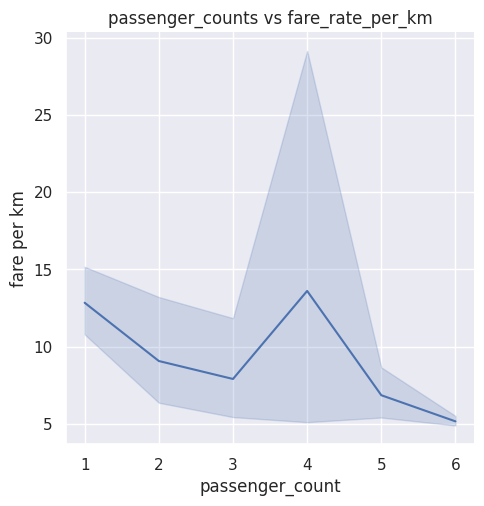

In [79]:
sns.relplot(x="passenger_count", y = "fare per km", kind = 'line', data = df_distance)
plt.title("passenger_counts vs fare_rate_per_km")
plt.show()

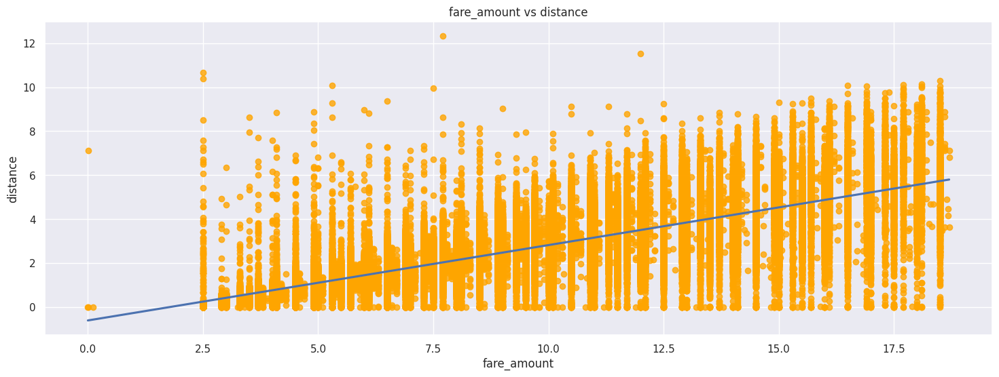

In [80]:
sns.regplot( x = "fare_amount", y="distance", data = df_distance, scatter_kws = {'color' : 'orange'})
plt.title("fare_amount vs distance")
plt.show()

Text(0.5, 1.0, 'passenger_count vs distance')

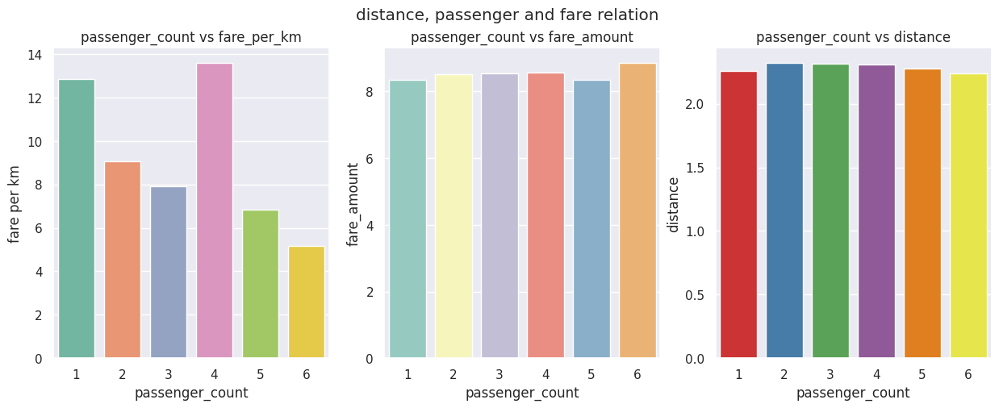

In [82]:
# multiple comparisions with respect to passenger counts
fig, axes = plt.subplots(1, 3, sharex=True, figsize=(15,5))
fig.suptitle('distance, passenger and fare relation')

sns.barplot(ax=axes[0],x="passenger_count", y = "fare per km",data = df_distance, ci = None, palette = "Set2")
axes[0].set_title('passenger_count vs fare_per_km')
sns.barplot(ax=axes[1],x="passenger_count", y = "fare_amount", data = df_distance, ci = None, palette = "Set3")
axes[1].set_title('passenger_count vs fare_amount')
sns.barplot(ax=axes[2],x="passenger_count", y = "distance", data = df_distance,  ci = None, palette = "Set1")
axes[2].set_title('passenger_count vs distance')


# ❄️ Data Preprocessing and Normalization

### Import Libraries

In [5]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import StandardScaler

In [6]:
#copy dataframe
data = dataframe.copy()
#drop missing value
data = data.dropna()
#drop unnecessary columns
data = data.drop(['Unnamed: 0', 'key',  'pickup_datetime'], axis =1)

#outlier function
def outlier(dataset, col):

    Q1 = dataset[col].quantile(0.25)
    Q3 = dataset[col].quantile(0.75)
    IQR = Q3 - Q1
    lower = Q1 - 1.5*IQR
    upper = Q3 + 1.5*IQR
    result =(lower,upper)

    return list(result)

#data preprocessed
def data_preprocessed(dataset):

  #pick and drop at same location
  zero_distance = dataset[(dataset.pickup_longitude ==dataset['dropoff_longitude']) & (dataset.pickup_latitude==dataset['dropoff_latitude'])].index
  dataset.drop(zero_distance, inplace=True)
  #outlier remove
  dataset = dataset[(dataset.pickup_longitude>=outlier(dataset, 'pickup_longitude')[0]) & (dataset.pickup_longitude<=outlier(dataset, 'pickup_longitude')[1])]
  dataset = dataset[(dataset.pickup_latitude>=outlier(dataset, 'pickup_latitude')[0]) & (dataset.pickup_latitude<=outlier(dataset, 'pickup_latitude')[1])]
  dataset = dataset[(dataset.dropoff_longitude>=outlier(dataset, 'dropoff_longitude')[0]) & (dataset.dropoff_longitude<=outlier(dataset, 'dropoff_longitude')[1])]
  dataset = dataset[(dataset.dropoff_latitude>=outlier(dataset, 'dropoff_latitude')[0]) & (dataset.dropoff_latitude<=outlier(dataset, 'dropoff_latitude')[1])]
  dataset = dataset[(dataset.fare_amount>=outlier(dataset, 'fare_amount')[0]) & (dataset.fare_amount<=outlier(dataset, 'fare_amount')[1])]

  return dataset.reset_index(drop=True)

#preprocessed dataset
data_prep = data_preprocessed(data)



#drop outlier of passenger column
data_prep['passenger_count'].value_counts()
#find index of outlier
index_passenger_outlier = data_prep[data_prep['passenger_count']==208].index
#drop outlier by index
data_prep = data_prep.drop(index=index_passenger_outlier)
#ignore zero passenger
data_prep = data_prep[data_prep['passenger_count']>=1]

print("Fully Preprocessed Data for Model Training: \n\n")
data_prep




Fully Preprocessed Data for Model Training: 




,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,7.5,-73.999817,40.738354,-73.999512,40.723217,1
1,7.7,-73.994355,40.728225,-73.994710,40.750325,1
2,12.9,-74.005043,40.740770,-73.962565,40.772647,1
3,5.3,-73.976124,40.790844,-73.965316,40.803349,3
4,9.7,-73.975187,40.745767,-74.002720,40.743537,1
...,...,...,...,...,...,...
162330,12.0,-73.983070,40.760770,-73.972972,40.754177,1
162331,3.0,-73.987042,40.739367,-73.986525,40.740297,1
162332,7.5,-73.984722,40.736837,-74.006672,40.739620,1
162333,14.5,-73.997124,40.725452,-73.983215,40.695415,1


In [7]:
#passengers count
print("Total Number of Rides based on Passenger Counts")
data_prep['passenger_count'].value_counts()

Total Number of Rides based on Passenger Counts


1    112503
2     23678
5     11325
3      7288
4      3498
6      3440
Name: passenger_count, dtype: int64

### 😵 oversampling for data balancing based on passenger count to remove imbalance in dataset

In [21]:
#dataset1
dataset1 = data_prep.copy()

In [11]:
#oversampling for data balancing based on passenger count
sm = SMOTE(random_state = 42)
data_balanced, passenger_balanced = sm.fit_resample(dataset1[['pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude','fare_amount', 'passenger_count']], dataset1['passenger_count'].ravel())

In [12]:
print("Dataset after data balancing based on passenger_count:\n")
data_balanced

Dataset after data balancing based on passenger_count:



,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,fare_amount,passenger_count
0,-73.999817,40.738354,-73.999512,40.723217,7.5,1
1,-73.994355,40.728225,-73.994710,40.750325,7.7,1
2,-74.005043,40.740770,-73.962565,40.772647,12.9,1
3,-73.976124,40.790844,-73.965316,40.803349,5.3,3
4,-73.975187,40.745767,-74.002720,40.743537,9.7,1
...,...,...,...,...,...,...
675013,-73.974359,40.783712,-73.974827,40.787391,4.5,6
675014,-73.978134,40.760984,-73.986552,40.749113,6.0,6
675015,-73.964530,40.766739,-73.959783,40.797134,12.0,6
675016,-73.955618,40.779708,-73.993230,40.737617,17.0,6


In [13]:
#passengers count
print("Total Number of Rides based on Passenger Counts")
data_balanced['passenger_count'].value_counts()

Total Number of Rides based on Passenger Counts


1    112503
3    112503
5    112503
2    112503
4    112503
6    112503
Name: passenger_count, dtype: int64

In [14]:
features = data_balanced[['pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'passenger_count']]

target = data_balanced['fare_amount']

#👇Training, Test and Validation Dataset (Data Spliting)✂️

In [15]:
# Split your data into 65% training and 35% remaining (testing + validation)
X_train, X_remaining, y_train, y_remaining = train_test_split(features, target, test_size=0.35, random_state=42, stratify=features['passenger_count'])

In [17]:
# Further split the remaining data into 57.14% testing and 42.86% validation
# (20% of the original data for testing and 15% for validation)
X_test, X_val, y_test, y_val = train_test_split(X_remaining, y_remaining, test_size=0.42857, random_state=42, stratify=X_remaining['passenger_count'])

In [18]:
print('passengers count after applying oversampling for train data: ')
X_train['passenger_count'].value_counts()

passengers count after applying oversampling for train data: 


5    73127
6    73127
2    73127
1    73127
3    73127
4    73126
Name: passenger_count, dtype: int64

In [19]:
print('passengers count after applying oversampling for validation data: ')
X_val['passenger_count'].value_counts()

passengers count after applying oversampling for validation data: 


4    16876
5    16876
1    16876
2    16875
6    16875
3    16875
Name: passenger_count, dtype: int64

In [34]:
#datetime to numeric
#X_train['pickup_datetime'] = X_train['pickup_datetime'].apply(lambda x: int(x.timestamp()))

In [20]:
X_train.head(3)

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
541382,-73.982881,40.726446,-73.985742,40.757792,5
538032,-73.978204,40.778506,-74.003008,40.752463,5
521048,-73.988299,40.728724,-73.979313,40.764933,5


### 👇Data Normalization

In [22]:
#training data normalization
sc = StandardScaler()
X_train_scaled = sc.fit_transform(X_train)



In [23]:
#testing data normalization
X_val_scaled = sc.transform(X_val)

#🏡 Model Building

### ⛺ Import Libraries

In [24]:
#different types of regression model
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.neighbors import KNeighborsRegressor
from xgboost import XGBRegressor
from sklearn.ensemble import RandomForestRegressor

#error
from sklearn.metrics import mean_absolute_error
#accuracy and R1
from sklearn.metrics import r2_score, explained_variance_score

#best parameters for hyperparameter tuning
from sklearn.model_selection import GridSearchCV
#evaluation of dataset
from sklearn.model_selection import StratifiedKFold


### ⛺ multiple regression model comparision



In [25]:
#build models
models = {}

models['Linear Regression'] = {'model' : LinearRegression()}
models['LASSO'] = {'model' : Lasso(alpha =0.1)}
models['Ridge'] = {'model' : Ridge(alpha = 1.0)}
models['KNeighbors Regression'] = {'model' : KNeighborsRegressor()}
models['XGBoost Regression'] = {'model' : XGBRegressor()}
models['RandomForest Regression'] = {'model' : RandomForestRegressor()}

models

{'Linear Regression': {'model': LinearRegression()},
 'LASSO': {'model': Lasso(alpha=0.1)},
 'Ridge': {'model': Ridge()},
 'KNeighbors Regression': {'model': KNeighborsRegressor()},
 'XGBoost Regression': {'model': XGBRegressor(base_score=None, booster=None, callbacks=None,
               colsample_bylevel=None, colsample_bynode=None,
               colsample_bytree=None, device=None, early_stopping_rounds=None,
               enable_categorical=False, eval_metric=None, feature_types=None,
               gamma=None, grow_policy=None, importance_type=None,
               interaction_constraints=None, learning_rate=None, max_bin=None,
               max_cat_threshold=None, max_cat_to_onehot=None,
               max_delta_step=None, max_depth=None, max_leaves=None,
               min_child_weight=None, missing=nan, monotone_constraints=None,
               multi_strategy=None, n_estimators=None, n_jobs=None,
               num_parallel_tree=None, random_state=None, ...)},
 'RandomForest R

y_val: 
212348     5.3
607126     9.5
373867     4.1
616913     5.5
635066    15.5
          ... 
244373     4.1
443224    16.5
594408     7.5
138338    16.1
547129     8.0
Name: fare_amount, Length: 101253, dtype: float64
y_pred: 
[8.41068008 8.93234387 8.53754445 ... 8.50149636 7.8546895  8.76977335]
-----------Linear Regression-------------
mean_absolute_error: 2.821668766336
R2 score: 0.01300829212298027
explained_variance_score: 0.013021019374433007
y_val: 
212348     5.3
607126     9.5
373867     4.1
616913     5.5
635066    15.5
          ... 
244373     4.1
443224    16.5
594408     7.5
138338    16.1
547129     8.0
Name: fare_amount, Length: 101253, dtype: float64
y_pred: 
[8.54310194 8.65949909 8.53301956 ... 8.34308089 8.46113522 8.61921696]
-----------LASSO-------------
mean_absolute_error: 2.82679799823965
R2 score: 0.009223979612302702
explained_variance_score: 0.009237856358791818
y_val: 
212348     5.3
607126     9.5
373867     4.1
616913     5.5
635066    15.5
        

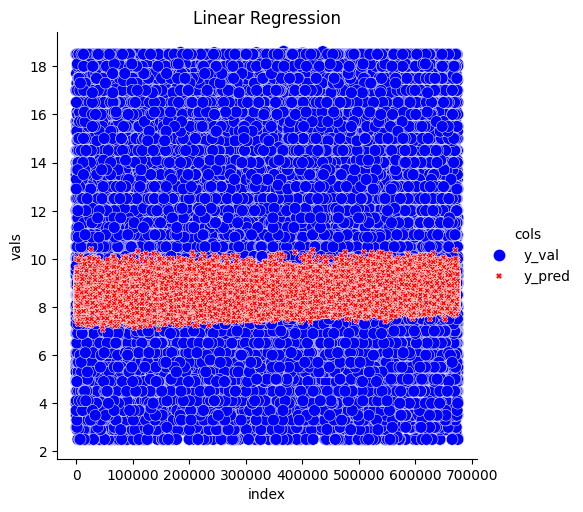

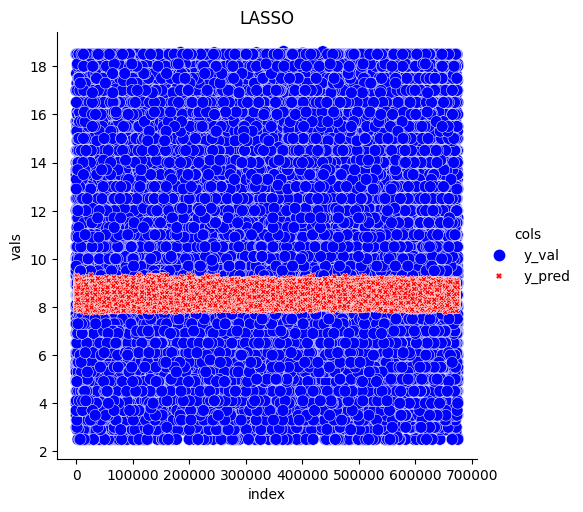

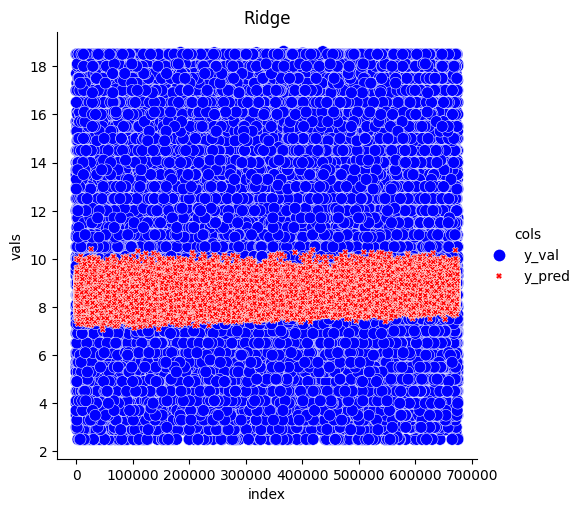

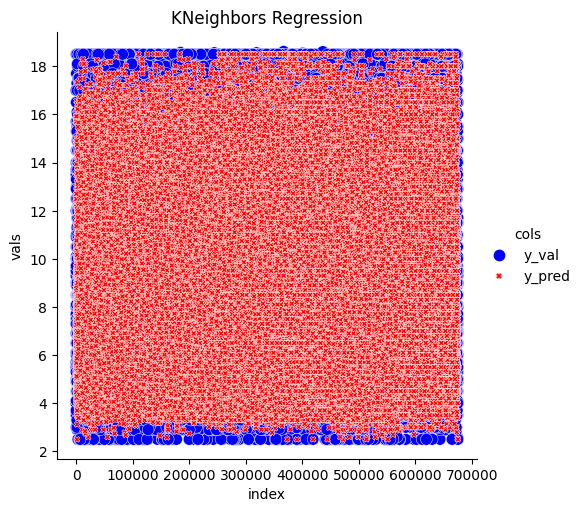

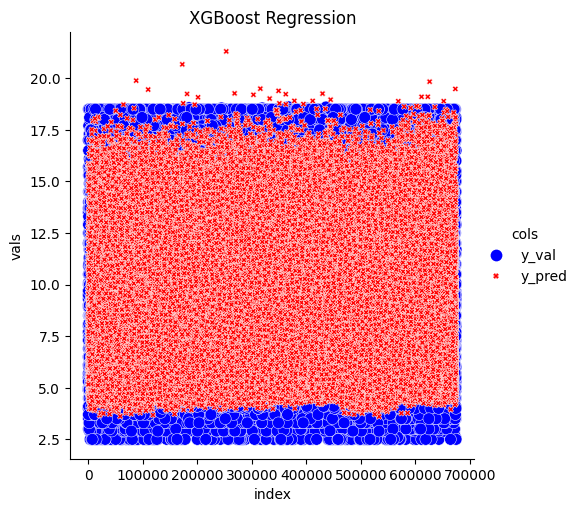

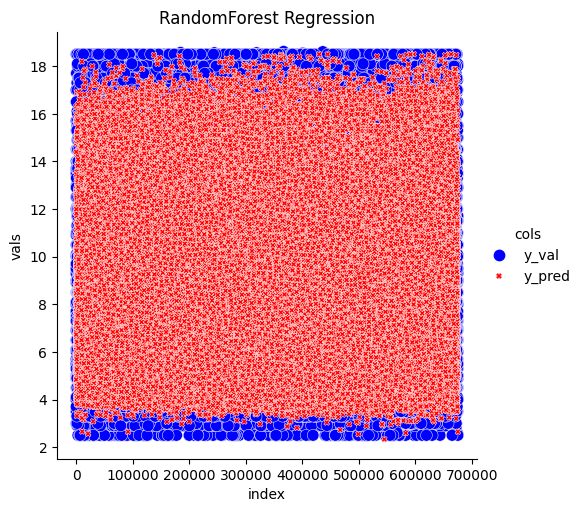

In [26]:
model_name =[]
build_models =[]


for name, model in models.items():
  trained_model = model['model'].fit(X_train_scaled, y_train)
  model_name.append(name)
  build_models.append(trained_model)
  #joblib.dump(reg, '_model.joblib')
  y_pred = trained_model.predict(X_val_scaled)

  print("y_val: ")
  print(y_val)
  print("y_pred: ")
  print(y_pred)
  mae = mean_absolute_error(y_val, y_pred)
  r2 = r2_score(y_val, y_pred, multioutput='variance_weighted')
  vscore =  explained_variance_score(y_val, y_pred)
  print("-----------"+name+"-------------")
  print(f"mean_absolute_error: {mae}")
  print(f"R2 score: {r2}")
  print(f"explained_variance_score: {vscore}")
  dfm = pd.DataFrame({'index': y_val.index.array, 'y_val': y_val, 'y_pred': y_pred})
  dfmelt = dfm.melt( 'index', var_name='cols', value_name='vals')
  sns.relplot(x= 'index', y="vals", hue='cols', data=dfmelt, size="cols", style="cols",
  palette=["b", "r"]).set(title=name)

#dictionary of models

build_models_dict = dict(zip(model_name, build_models))

<h4>👇 save models</h4>

In [27]:
#model keys
build_models_dict.keys()

dict_keys(['Linear Regression', 'LASSO', 'Ridge', 'KNeighbors Regression', 'XGBoost Regression', 'RandomForest Regression'])

In [28]:
#model values
build_models_dict.values()

dict_values([LinearRegression(), Lasso(alpha=0.1), Ridge(), KNeighborsRegressor(), XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...), RandomForestRegressor()])

In [29]:
#save models
for k, m in zip(build_models_dict.keys(),build_models_dict.values()):
  joblib.dump(m, k.replace(" ", "_")+'_model.joblib')

**🌱 By comparing the other models, K-Nearest Neighbor(KNN) is showing good performance.**

-----------KNeighbors Regression-------------
- mean_absolute_error: 0.8661504607992807
- R2 score: 0.8210252844357486
- explained_variance_score: 0.8217878880443168



#💥 Cross-Validation and Apply gridsearch for best model hyperparameters over KNN

In [30]:
cv_folds = StratifiedKFold(n_splits = 4,
                           random_state = 42, shuffle=True)

In [31]:

param_list = {
    'n_neighbors' : [2,3,4,5],
    'weights' : ['uniform', 'distance'],
    'p': [1, 2, 3]
}

grid = GridSearchCV(estimator= KNeighborsRegressor(),
                    param_grid = param_list,
                    cv = 4,
                    verbose= 1,
                    #scoring='explained_variance_score',
                    scoring='neg_mean_absolute_error',
                    return_train_score=True

                    )

In [32]:
grid.fit(X_train_scaled, y_train)

Fitting 4 folds for each of 24 candidates, totalling 96 fits


GridSearchCV(cv=4, estimator=KNeighborsRegressor(),
             param_grid={'n_neighbors': [2, 3, 4, 5], 'p': [1, 2, 3],
                         'weights': ['uniform', 'distance']},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

<h4>👇 Best Parameters</h4>

In [33]:
print("Best Parameters: ", grid.best_params_)
print("Best score:", grid.best_score_)

Best Parameters:  {'n_neighbors': 2, 'p': 2, 'weights': 'distance'}
Best score: -0.7544463908620311


<h4>👇 KNN Regressor with Hyperparameter</h4>

y_val: 
212348     5.3
607126     9.5
373867     4.1
616913     5.5
635066    15.5
          ... 
244373     4.1
443224    16.5
594408     7.5
138338    16.1
547129     8.0
Name: fare_amount, Length: 101253, dtype: float64
y_pred: 
[ 5.54101292  8.78236498  4.1        ...  7.5        13.16879602
  8.        ]
-----------KNN After Optimization-------------
mean_absolute_error: 0.6793747694790727
R2 score: 0.831388180005865
explained_variance_score: 0.8318086075538345


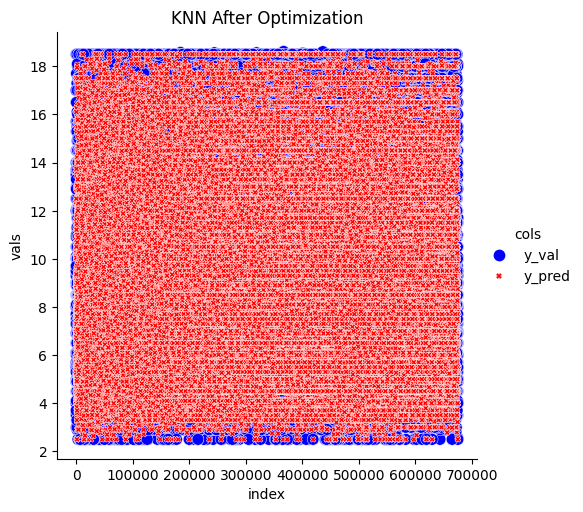

In [38]:
knn_optimized = KNeighborsRegressor(n_neighbors=2, p=2, weights='distance')

model_knn_opt = knn_optimized.fit(X_train_scaled, y_train)
y_pred = model_knn_opt.predict(X_val_scaled)

print("y_val: ")
print(y_val)
print("y_pred: ")
print(y_pred)
mae = mean_absolute_error(y_val, y_pred)
r2 = r2_score(y_val, y_pred, multioutput='variance_weighted')
vscore =  explained_variance_score(y_val, y_pred)

print("-----------"+"KNN After Optimization"+"-------------")
print("mean_absolute_error:", mae)
print("R2 score:", r2)
print("explained_variance_score:", vscore)

dfm1 = pd.DataFrame({'index': y_val.index.array, 'y_val': y_val, 'y_pred': y_pred})
dfmelt1 = dfm1.melt( 'index', var_name='cols', value_name='vals')
sns.relplot(x= 'index', y="vals", hue='cols', data=dfmelt1, size="cols", style="cols",
palette=["b", "r"]).set(title="KNN After Optimization")

-----------KNN After Optimization-------------

- mean_absolute_error: 0.6793747694790727
- R2 score: 0.831388180005865
- explained_variance_score: 0.8318086075538345

# 👇 Useen / Test Data Prediction for Model Evaluation

In [34]:
#Unseen Test data
X_test.head(5)

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
404761,-73.993141,40.722452,-74.000335,40.738019,4
468781,-74.002563,40.744173,-73.963549,40.760831,5
626658,-73.988096,40.743500,-74.000465,40.735479,6
239815,-74.005739,40.718092,-73.991020,40.736079,2
81826,-73.981897,40.746373,-74.000335,40.730122,1


In [35]:
X_test['passenger_count'].value_counts()

4    22501
6    22501
2    22501
3    22501
5    22500
1    22500
Name: passenger_count, dtype: int64

In [36]:
y_test

404761    12.0
468781    10.9
626658     6.5
239815     7.7
81826      7.7
          ... 
70004      6.9
523032    12.5
304057     6.1
489361    15.5
36834      8.9
Name: fare_amount, Length: 135004, dtype: float64

In [40]:

#data normalization
test_unseen_scaled = sc.transform(X_test)
y_pred_test = model_knn_opt.predict(test_unseen_scaled)
print("-----test data evaluation after KNN Optimization-----")
print("y_test: ")
print(y_test)
print("y_pred_test: ")
print(y_pred_test)
mae = mean_absolute_error(y_test, y_pred_test)
print(f"mae for test_data: {mae}")
r2 = r2_score(y_test, y_pred_test, multioutput='variance_weighted')
print(f"r2_score for test_data: {r2}")
vscore =  explained_variance_score(y_test, y_pred_test)
print(f"variance score for test_data: {vscore}")




-----test data evaluation after KNN Optimization-----
y_test: 
404761    12.0
468781    10.9
626658     6.5
239815     7.7
81826      7.7
          ... 
70004      6.9
523032    12.5
304057     6.1
489361    15.5
36834      8.9
Name: fare_amount, Length: 135004, dtype: float64
y_pred_test: 
[ 8.5        10.9         6.5        ...  6.1        15.5
  9.03898633]
mae for test_data: 0.6837286677963623
r2_score for test_data: 0.8301758191732105
variance score for test_data: 0.8305690731447033


<h4>👇 Save Model</h4>

In [41]:
 m=model_knn_opt
 joblib.dump(m, 'knn_hyper_opti_model.joblib')


['knn_hyper_opti_model.joblib']

<h4>👇 Load Model</h4>

In [43]:
def load_model(loader_name, inputs, actual_outputs):
  knn_opt = joblib.load(loader_name)
  predictions = knn_opt.predict(inputs)
  mae = mean_absolute_error(actual_outputs, predictions)
  print(f"mae : $ {mae}")
  return np.array(actual_outputs), predictions

loader_name = "/content/knn_hyper_opti_model.joblib"
inputs = test_unseen_scaled
actual_outputs = y_test
load_model(loader_name, inputs, actual_outputs)

mae : $ 0.6837286677963623


(array([12. , 10.9,  6.5, ...,  6.1, 15.5,  8.9]),
 array([ 8.5       , 10.9       ,  6.5       , ...,  6.1       ,
        15.5       ,  9.03898633]))

# 🙊 Test with single data

In [45]:
X_test.iloc[0]

pickup_longitude    -73.993141
pickup_latitude      40.722452
dropoff_longitude   -74.000335
dropoff_latitude     40.738019
passenger_count       4.000000
Name: 404761, dtype: float64

In [59]:
# test data features
pickup_longitude = -73.993633
pickup_latitude = 40.722452
dropoff_longitude = -74.000335
dropoff_latitude = 40.738019
passenger_count = 4

new_input = [ pickup_longitude, pickup_latitude, dropoff_longitude, dropoff_latitude, passenger_count]

In [60]:
print(f'input details: {new_input}')

input details: [-73.993633, 40.722452, -74.000335, 40.738019, 4]


In [64]:
def load_model_single_input(loader_model_name, inputs, actual_outputs):
  knn_optimum = joblib.load(loader_name)
  #scaled
  inputs_scaled = sc.transform(inputs)
  predictions =knn_optimum.predict(inputs_scaled)

  return actual_outputs, predictions

loader_model_name = "/content/knn_hyper_opti_model.joblib"
inputs = np.array(new_input).reshape(1, -1)
actual_outputs = y_test.loc[y_test.index[0]]
load_model_single_input(loader_name, inputs, actual_outputs)

(12.0, array([8.5]))

### 📊 Summary

 Our model for Uber fare prediction achieves exceptional performance, particularly excelling with KNN (K Nearest Neighbors). Through meticulous parameter tuning with GridSearchCV, we optimized the model to deliver highly accurate fare estimates. Moving forward, future enhancements could include exploring additional features, added different models, fine tuning, training with higher infrastructure, integrating real-time data, and enhancing user experience with a user-friendly interface. 🚖🔍🚀
